<a href="https://colab.research.google.com/github/9645258/aiffel/blob/main/01_exploration/%5BE-14%5Dexploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **🎄 EXPLORATION 14**

# **🌲 EXPLORATION 14-1 : CIFAR-10 이미지 생성**

## **🌿 01_데이터 준비**

### 🍃 **01-1_필요 라이브러리 import**

In [ ]:
import os 
import glob
import time
import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from keras.layers.convolutional import UpSampling2D, Conv2D
from IPython import display
import matplotlib.pyplot as plt
from matplotlib.pylab import rcParams
%matplotlib inline

### 🍃 **01-2_데이터셋 import**

In [ ]:
cifar10 = tf.keras.datasets.cifar10
(train_x, _), (test_x, _) = cifar10.load_data()

### 🍃 **01-3_데이터셋 Shape 확인**

In [ ]:
train_x.shape

(50000, 32, 32, 3)

### 🍃 **01-3_픽셀 Max, Min 값 확인**

In [ ]:
print('Max pixel:', train_x.max())
print('Min pixel:', train_x.min())

Max pixel: 255
Min pixel: 0


### 🍃 **01-4_픽셀 정규화**

In [ ]:
train_x = (train_x - 127.5) / 127.5 

In [ ]:
print('Max pixel:', train_x.max())
print('Min pixel:', train_x.min())

Max pixel: 1.0
Min pixel: -1.0


### 🍃 **01-5_정규화 진행 후 데이터셋 Shape 확인**

In [ ]:
train_x.shape

(50000, 32, 32, 3)

### 🍃 **01-6_랜덤 이미지 확인**

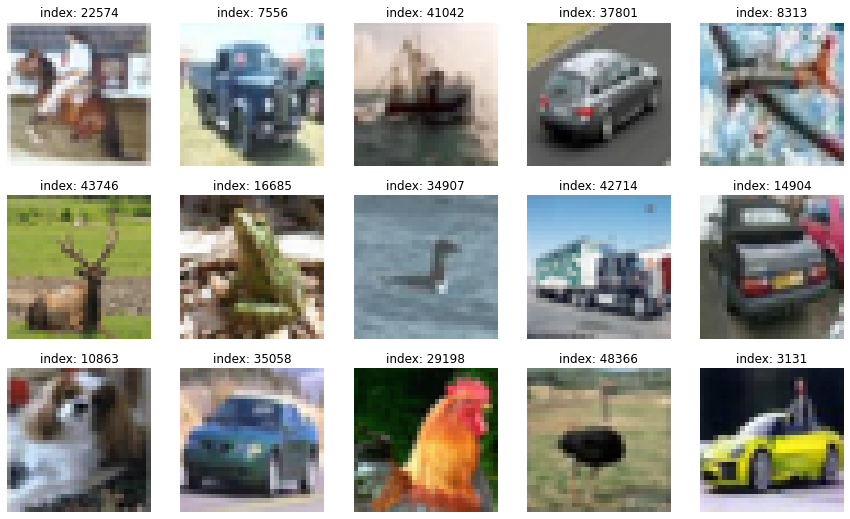

In [ ]:
plt.figure(figsize=(15, 9))

for i in range(15):
    plt.subplot(3, 5, i+1)
    random_index = np.random.randint(1, 50000)
    plt.imshow((train_x[random_index] + 1)/2)
    plt.title(f'index: {random_index}')
    plt.axis('off')
plt.show()

## **🌿 02_생성자 모델 구현**

### 🍃 **02-1_생성자 모델 함수 정의**

In [ ]:
def make_generator_model_one():
    
    # Start
    model = tf.keras.Sequential()
    
    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))
    
    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    
    return model

### 🍃 **02-2_모델 Summary 출력**

In [ ]:
generator_one = make_generator_model_one()
generator_one.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16384)             1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16384)             0         
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 128)         819200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 128)         0

### 🍃 **02-3_노이즈 벡터 생성**

In [ ]:
noise = tf.random.normal([1, 100])
generated_image = generator_one(noise, training=False)

### 🍃 **02-4_노이즈 벡터 Shape 확인**

In [ ]:
generated_image.shape

TensorShape([1, 32, 32, 3])

### 🍃 **02-5_노이즈 벡터 시각화**

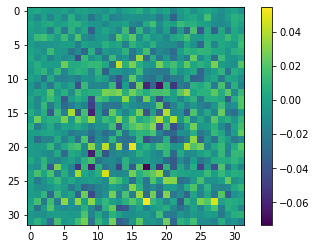

In [ ]:
plt.imshow(generated_image[0, :, :, 0])
plt.colorbar()
plt.show()

## **🌿 03_판별자 모델 구현**

### 🍃 **03-1_판별자 모델 함수 정의**

In [ ]:
def make_discriminator_model_one():
    
    # Start
    model = tf.keras.Sequential()
    
    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Third: Flatten Layer
    model.add(layers.Flatten())
    
    # Fourth: Dense Layer
    model.add(layers.Dense(1))
    
    return model

### 🍃 **03-2_모델 Summary 출력**

In [ ]:
discriminator_one = make_discriminator_model_one()
discriminator_one.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 64)        4864      
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 16, 16, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 128)         204928    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 8, 8, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 8192)             

## **🌿 04_손실함수 및 최적화함수 정의**

### 🍃 **04-1_손실함수 정의**

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### 🍃 **04-2_generator loss 정의**

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

### 🍃 **04-3_discriminator loss 정의**

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### 🍃 **04-4_discriminator accuracy 계산**

In [ ]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

### 🍃 **04-5_최적화 함수 정의**

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### 🍃 **04-6_샘플 생성**

In [ ]:
noise_dim = 100
num_examples_to_generate = 16

### 🍃 **04-7_고정 Seed 생성**

In [ ]:
seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

## **🌿 05_훈련 과정 상세 기능 구현**

### 🍃 **05-1_미니배치 구성**

In [ ]:
BUFFER_SIZE = 50000
BATCH_SIZE = 256

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

### 🍃 **05-2_Train Step 함수 정의**

In [ ]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator_one(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator_one(images, training=True)
        fake_output = discriminator_one(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator_one.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator_one.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator_one.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator_one.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

### 🍃 **05-3_일정 학습 당 샘플 생성 함수 정의**

In [ ]:
def generate_and_save_images(model, epoch, it, sample_seeds):
    
    predictions = model(sample_seeds, training=False)
    
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow(np.array(predictions[i] * 127.5 + 127.5).astype('uint8'))
        plt.axis('off')
        
    plt.savefig('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/generated_samples/epoch_{:04d}_iter_{:03d}.png'.format(epoch, it))
    
    plt.show()

### 🍃 **05-4_학습 결과 시각화 함수 정의**

In [ ]:
rcParams['figure.figsize'] = 15, 12# matlab 차트의 기본 크기를 15, 6 으로 지정

def draw_train_history(history, epoch):
    # summarize history for loss
    plt.subplot(211)
    plt.plot(history['gen_loss'])
    plt.plot(history['disc_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('batch iters')
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')
    
    # summarize history for accuracy
    plt.subplot(212)
    plt.plot(history['fake_accuracy'])
    plt.plot(history['real_accuracy'])
    plt.title('discriminator accuracy')
    plt.xlabel('batch iters')
    plt.ylabel('accuracy')
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')
    
    # training_history 디렉토리에 epoch 별로 그래프를 이미지 파일로 저장
    plt.savefig('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/training_history/train_history_{:04d}.png'.format(epoch))
    
    plt.show()

### 🍃 **05-5_Check Point 설정**

In [ ]:
checkpoint_dir = '/Users/96452/00_work/00_aiffel/01_exploration/E-14/data/check_point'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator_one,
                                 discriminator=discriminator_one)

## **🌿 06_학습 진행**

### 🍃 **06-1_Train 함수 정의**

In [ ]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator_one, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator_one, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

### 🍃 **06-2_학습 횟수 및 저장 간격 설정**

In [ ]:
save_every = 5
EPOCHS = 500

### 🍃 **06-3_GPU 사용 확인**

In [ ]:
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

### 🍃 **06-4_학습 진행**

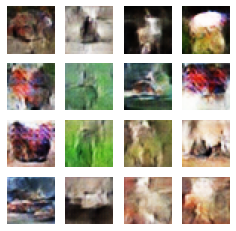

Time for training : 2500 sec


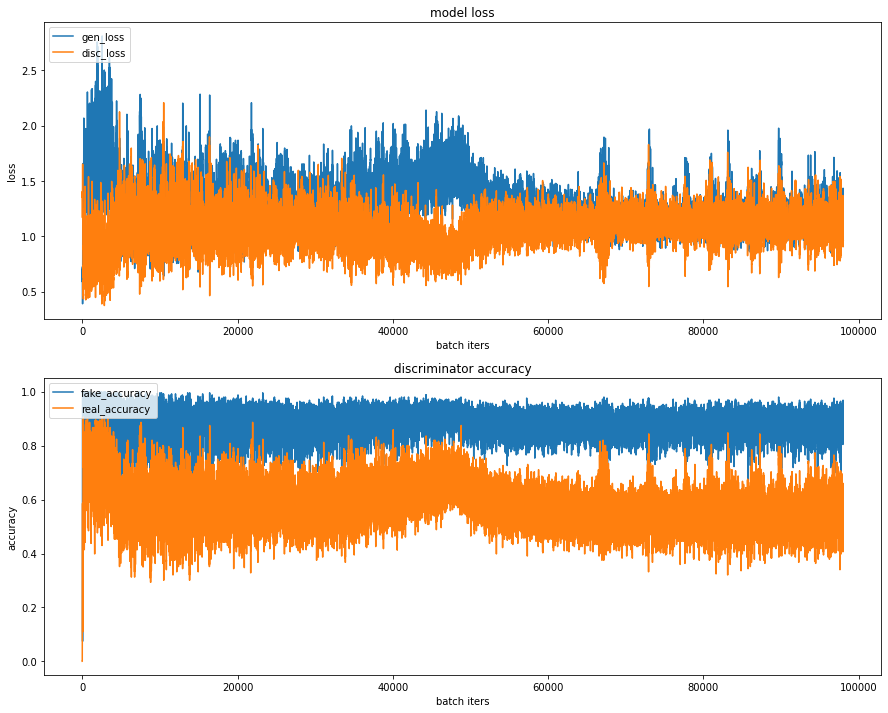

CPU times: total: 41min 49s
Wall time: 41min 42s


In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

### 🍃 **06-5_학습 결과 이미지 gif 생성**

In [ ]:
anim_file = 'G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/new_image/make_generator_model_one_fashion_mnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/generated_samples/epoch*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\76746540.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\76746540.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [ ]:
anim_file = 'G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/new_image/make_generator_model_one_fashion_loss_accuracy.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/training_history/train_history*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\3656380257.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\3656380257.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


### 🍃 **06-6_학습 결과 gif 시각화**

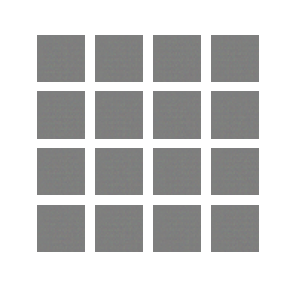

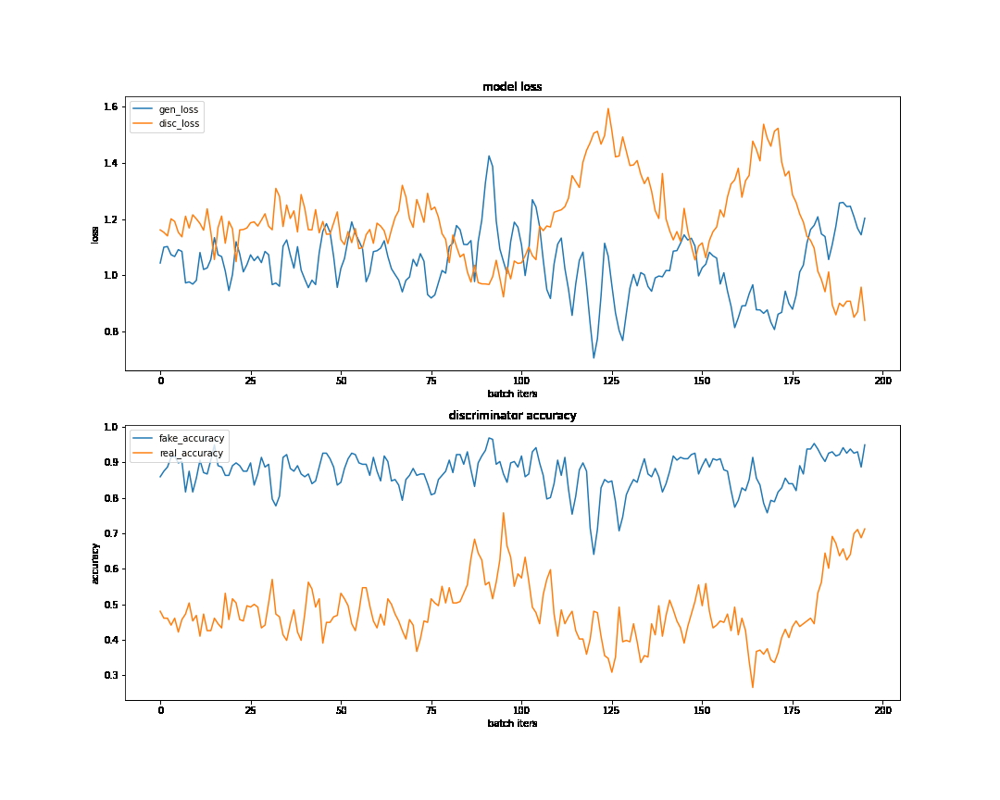

<hr>

# **🌲 EXPLORATION 14-2 : CIFAR-10 생성 이미지 1차 개선**

## **🌿 01_생성자 모델 구현**

### 🍃 **01-1_생성자 모델 함수 정의**

In [ ]:
def make_generator_model_two():

  model = tf.keras.Sequential()
  
  model.add(layers.Dense(8 * 8 * 128, activation='relu', input_shape=(100,)))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Reshape((8, 8, 128)))

  model.add(layers.Conv2D(128, kernel_size=4, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2D(128, kernel_size=5, strides=1,padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  model.add(layers.Conv2D(128, kernel_size=5, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))
                      
  model.add(layers.Conv2D(3, kernel_size=5, strides=1, padding="same", activation='tanh'))
  
  return model

### 🍃 **01-2_모델 Summary 출력**

In [ ]:
generator_two = make_generator_model_two()
generator_two.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 8192)              827392    
_________________________________________________________________
batch_normalization_3 (Batch (None, 8192)              32768     
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 8192)              0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 128)         262272    
_________________________________________________________________
batch_normalization_4 (Batch (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 8, 8, 128)        

### 🍃 **01-3_노이즈 벡터 생성**

In [ ]:
noise = tf.random.normal([1, 100])
generated_image = generator_two(noise, training=False)

### 🍃 **01-4_노이즈 벡터 Shape 확인**

In [ ]:
generated_image.shape

TensorShape([1, 32, 32, 3])

## **🌿 02_판별자 모델 구현**

### 🍃 **02-1_판별자 모델 함수 정의**

In [ ]:
def make_discriminator_model_two():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(32, kernel_size=3, strides=2, input_shape=(32, 32, 3), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(64, kernel_size=3, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.8))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=3, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.8))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(256, kernel_size=3, strides=1, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.8))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid'))

    return model

### 🍃 **02-2_모델 Summary 출력**

In [ ]:
discriminator_two = make_discriminator_model_two()
discriminator_two.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 16, 16, 32)        896       
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 16, 16, 32)        0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 8, 8, 64)          18496     
_________________________________________________________________
batch_normalization_9 (Batch (None, 8, 8, 64)          256       
_________________________________________________________________
leaky_re_lu_12 (LeakyReLU)   (None, 8, 8, 64)          0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 8, 8, 64)         

## **🌿 03_학습 진행**

### 🍃 **03-1_학습 횟수 및 저장 간격 설정**

In [ ]:
save_every = 5
EPOCHS = 500

### 🍃 **03-2_학습 진행**

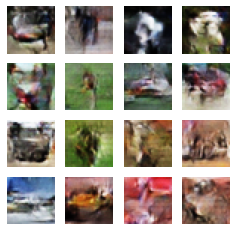

Time for training : 2561 sec


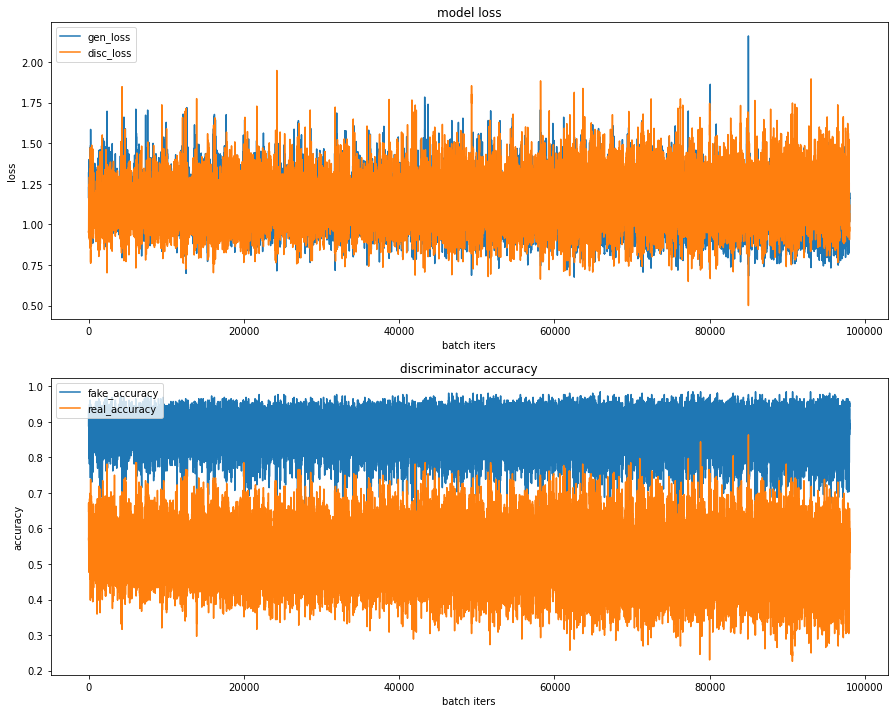

CPU times: total: 43min 15s
Wall time: 42min 43s


In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

### 🍃 **03-3_학습 결과 이미지 gif 생성**

In [ ]:
anim_file = 'G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/new_image/make_generator_model_two_fashion_mnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/generated_samples/epoch*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\1431360836.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\1431360836.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [ ]:
anim_file = '/Users/96452/00_work/00_aiffel/01_exploration/E-14/data/new_image/make_generator_model_two_fashion_loss_accuracy.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('/Users/96452/00_work/00_aiffel/01_exploration/E-14/data/training_history/train_history*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\2662880696.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\2662880696.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


### 🍃 **03-4_학습 결과 gif 시각화**

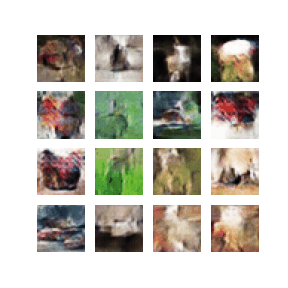

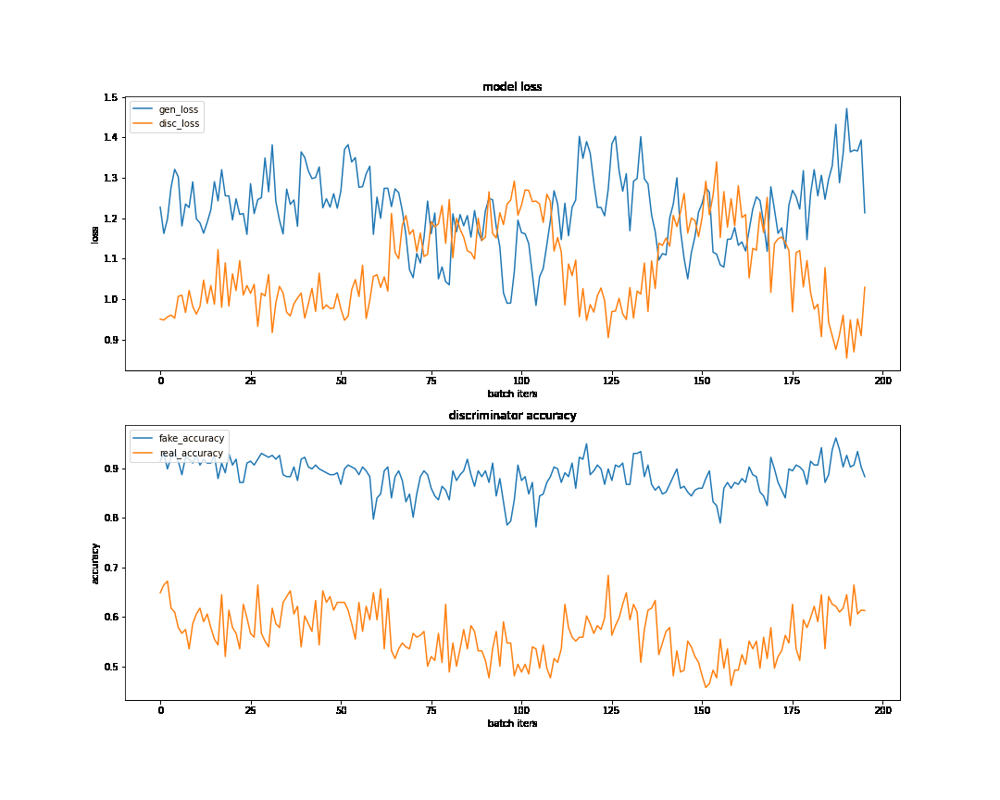

<hr>

# **🌲 EXPLORATION 14-3 : CIFAR-10 생성 이미지 2차 개선**

## **🌿 01_생성자 모델 구현**

### 🍃 **01-1_생성자 모델 함수 정의**

In [ ]:
def make_generator_model_three(in_shape=(32, 32, 3)):

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,), activation='relu'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))

    return model

### 🍃 **01-2_모델 Summary 출력**

In [ ]:
generator_three = make_generator_model_three()
generator_three.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 16384)             1638400   
_________________________________________________________________
batch_normalization_39 (Batc (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu_42 (LeakyReLU)   (None, 16384)             0         
_________________________________________________________________
reshape_5 (Reshape)          (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_12 (Conv2DT (None, 8, 8, 128)         819200    
_________________________________________________________________
batch_normalization_40 (Batc (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_43 (LeakyReLU)   (None, 8, 8, 128)       

### 🍃 **01-3_노이즈 벡터 생성**

In [ ]:
noise = tf.random.normal([1, 100])
generated_image = generator_three(noise, training=False)

## **🌿 02_판별자 모델 구현**

### 🍃 **02-1_판별자 모델 함수 정의**

In [ ]:
def make_discriminator_model_three():
    
    model = tf.keras.Sequential()
    
    model.add(layers.Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=[32, 32, 3]))
    model.add(layers.Conv2D(64, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))
    model.add(layers.Flatten())
    
    model.add(layers.Dense(512, activation='relu'))
    
    model.add(layers.Dense(1, activation='sigmoid'))
    
    return model    

### 🍃 **02-2_모델 Summary 출력**

In [ ]:
discriminator_three = make_discriminator_model_three()
discriminator_three.summary()

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_34 (Conv2D)           (None, 32, 32, 64)        1792      
_________________________________________________________________
conv2d_35 (Conv2D)           (None, 32, 32, 64)        36928     
_________________________________________________________________
batch_normalization_42 (Batc (None, 32, 32, 64)        256       
_________________________________________________________________
leaky_re_lu_45 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_18 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_36 (Conv2D)           (None, 32, 32, 128)       73856     
_________________________________________________________________
conv2d_37 (Conv2D)           (None, 32, 32, 128)     

## **🌿 03_학습 진행**

### 🍃 **03-1_학습 횟수 및 저장 간격 설정**

In [ ]:
save_every = 5
EPOCHS = 500

### 🍃 **03-2_학습 진행**

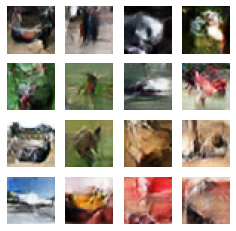

Time for training : 3059 sec


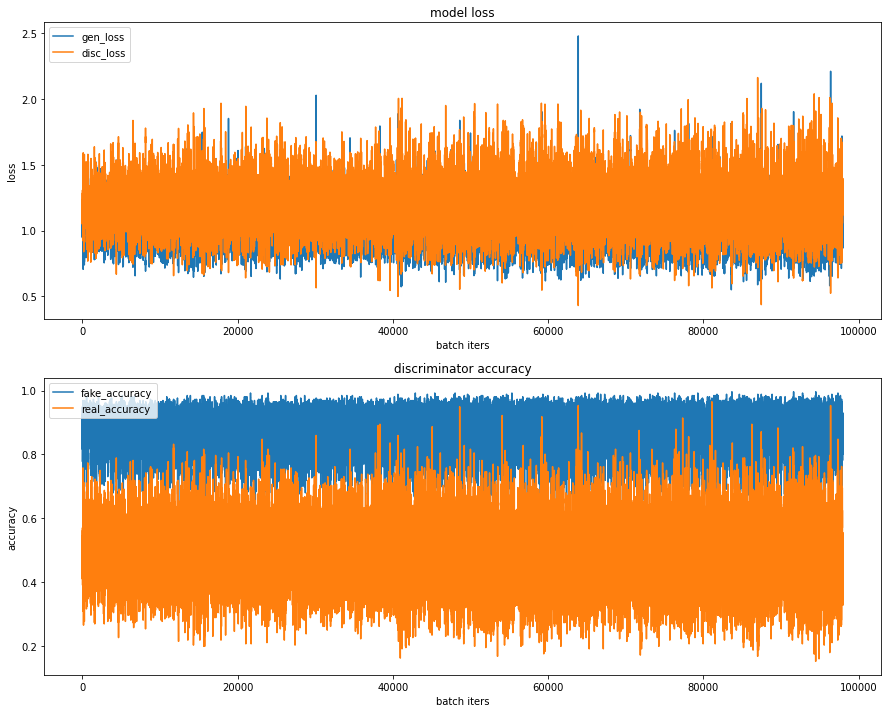

CPU times: total: 51min 27s
Wall time: 51min 2s


In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

### 🍃 **03-3_학습 결과 이미지 gif 생성**

In [ ]:
anim_file = 'G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/new_image/make_generator_model_three_fashion_mnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/generated_samples/epoch*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\429864902.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\429864902.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [ ]:
anim_file = 'G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/new_image/make_generator_model_three_fashion_loss_accuracy.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/training_history/train_history*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\2680642574.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\2680642574.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


### 🍃 **03-4_학습 결과 gif 시각화**

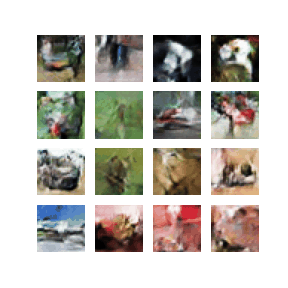

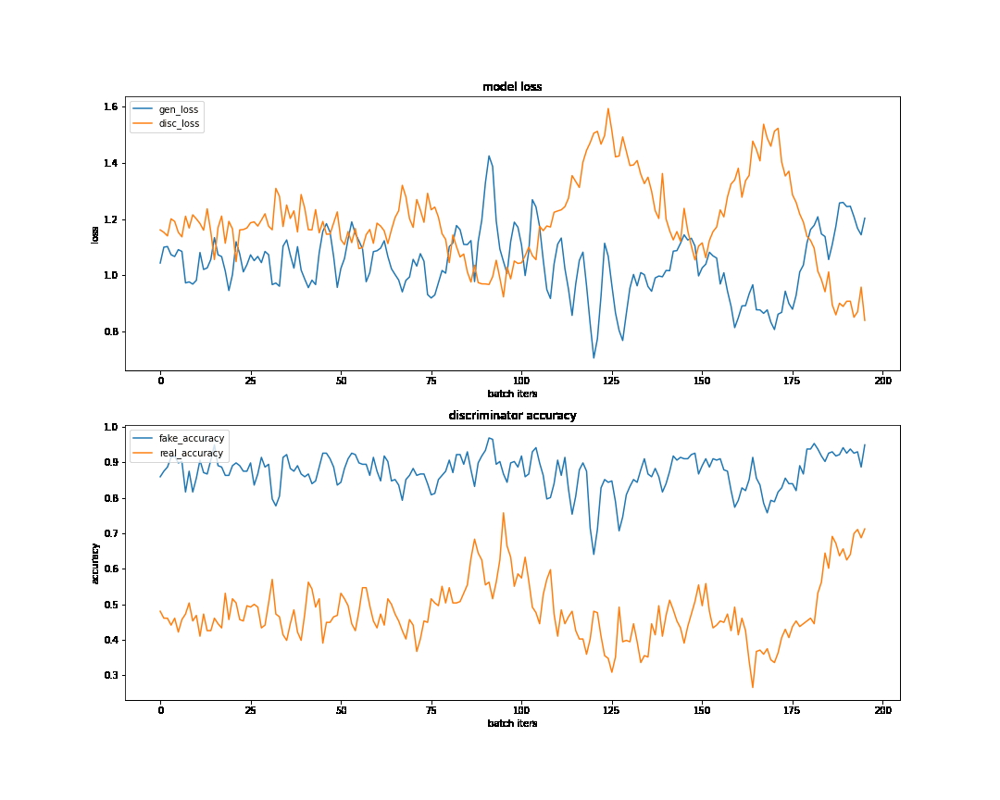

<hr>

# **🌲 EXPLORATION 14-4 : CIFAR-10 생성 이미지 3차 개선**

## **🌿 01_생성자 모델 구현**

### 🍃 **01-1_생성자 모델 함수 정의**

In [ ]:
def make_generator_model_four():

  model = tf.keras.Sequential()
  
  # first: Dense layer
  model.add(layers.Dense(8 * 8 * 128, activation='relu', input_shape=(100,)))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))
  
  # second: Reshape layer
  model.add(layers.Reshape((8, 8, 128)))

  # third: Conv2D layer
  model.add(layers.Conv2D(128, kernel_size=4, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # fourth: Conv2DTranspose layer
  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # fifth: Conv2D layer
  model.add(layers.Conv2D(128, kernel_size=5, strides=1,padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # sixth: Conv2DTranspose layer
  model.add(layers.Conv2DTranspose(128, 4, strides=2, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # seventh: Conv2D layer
  model.add(layers.Conv2D(128, kernel_size=5, strides=1, padding='same'))
  model.add(layers.BatchNormalization(momentum=0.9))
  model.add(layers.LeakyReLU(alpha=0.1))

  # eigth: Conv2D layer                   
  model.add(layers.Conv2D(3, kernel_size=5, strides=1, padding="same", activation='tanh'))
  
  return model

### 🍃 **01-2_모델 Summary 출력**

In [ ]:
generator_four = make_generator_model_four()
generator_four.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 8192)              827392    
_________________________________________________________________
batch_normalization_46 (Batc (None, 8192)              32768     
_________________________________________________________________
leaky_re_lu_49 (LeakyReLU)   (None, 8192)              0         
_________________________________________________________________
reshape_6 (Reshape)          (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_42 (Conv2D)           (None, 8, 8, 128)         262272    
_________________________________________________________________
batch_normalization_47 (Batc (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_50 (LeakyReLU)   (None, 8, 8, 128)       

### 🍃 **01-3_노이즈 벡터 생성**

In [ ]:
noise = tf.random.normal([1, 100])
generated_image = generator_four(noise, training=False)

### 🍃 **01-4_노이즈 벡터 Shape 확인**

In [ ]:
generated_image.shape

TensorShape([1, 32, 32, 3])

## **🌿 02_판별자 모델 구현**

### 🍃 **02-1_판별자 모델 함수 정의**

In [ ]:
def make_discriminator_model_four():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(128, kernel_size=3, strides=1, input_shape=(32, 32, 3), padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.25))

    model.add(layers.Flatten())

    model.add(layers.Dense(512, activation='relu'))


    model.add(layers.Dense(1, activation='sigmoid'))

    return model

### 🍃 **02-2_모델 Summary 출력**

In [ ]:
discriminator_four = make_discriminator_model_four()
discriminator_four.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_46 (Conv2D)           (None, 32, 32, 128)       3584      
_________________________________________________________________
batch_normalization_52 (Batc (None, 32, 32, 128)       512       
_________________________________________________________________
leaky_re_lu_55 (LeakyReLU)   (None, 32, 32, 128)       0         
_________________________________________________________________
dropout_22 (Dropout)         (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_47 (Conv2D)           (None, 16, 16, 128)       262272    
_________________________________________________________________
batch_normalization_53 (Batc (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_56 (LeakyReLU)   (None, 16, 16, 128)     

## **🌿 03_최적화함수 정의 및 미니 배치 구성**

### 🍃 **03-1_최적화 함수 정의**

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5)

### 🍃 **03-2_미니 배치 구성**

In [ ]:
BUFFER_SIZE = 50000
BATCH_SIZE = 16

## **🌿 04_학습 진행**

### 🍃 **04-1_학습 횟수 및 저장 간격 설정**

In [ ]:
save_every = 5
EPOCHS = 500

### 🍃 **03-2_학습 진행**

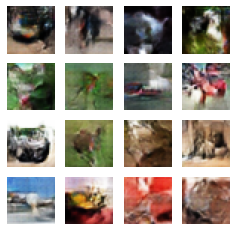

Time for training : 3844 sec


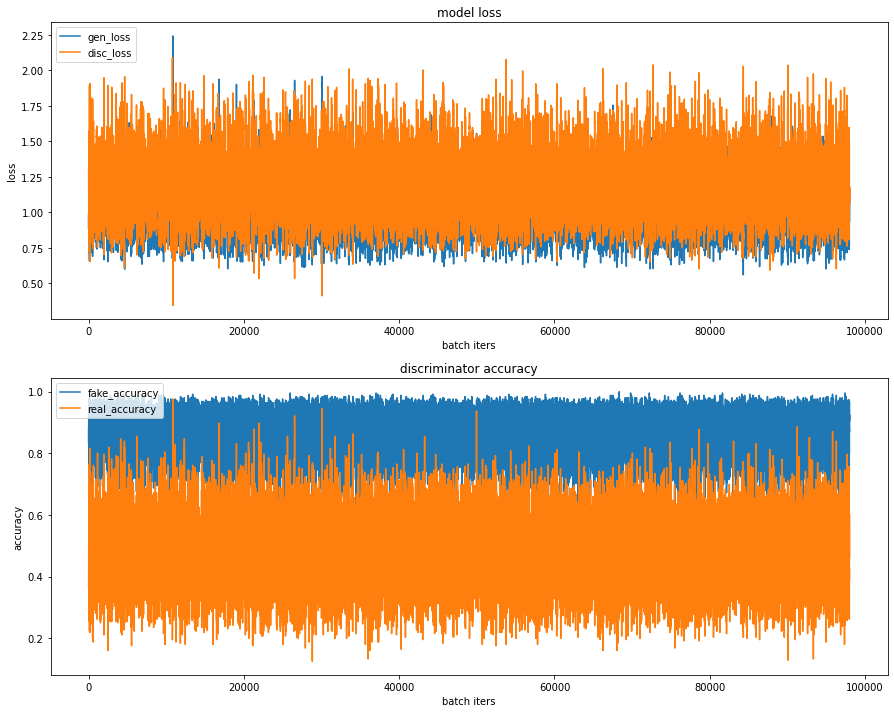

CPU times: total: 1h 4min 17s
Wall time: 1h 4min 6s


In [ ]:
%%time
with tf.device('/GPU:0'):
    train(train_dataset, EPOCHS, save_every)

### 🍃 **03-3_학습 결과 gif 이미지 생성**

In [ ]:
anim_file = 'G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/new_image/make_generator_model_four_fashion_mnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/generated_samples/epoch*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\3395473771.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\3395473771.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [ ]:
anim_file = 'G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/new_image/make_generator_model_four_fashion_loss_accuracy.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('G:/내 드라이브/Colab Notebooks/aiffel/01-2_exploration/E-14/data/training_history/train_history*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

C:\Users\96452\AppData\Local\Temp\ipykernel_11448\3886133618.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_11448\3886133618.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


### 🍃 **03-4_학습 결과 gif 이미지 시각화**

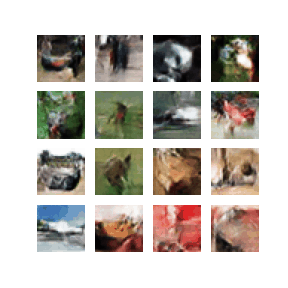

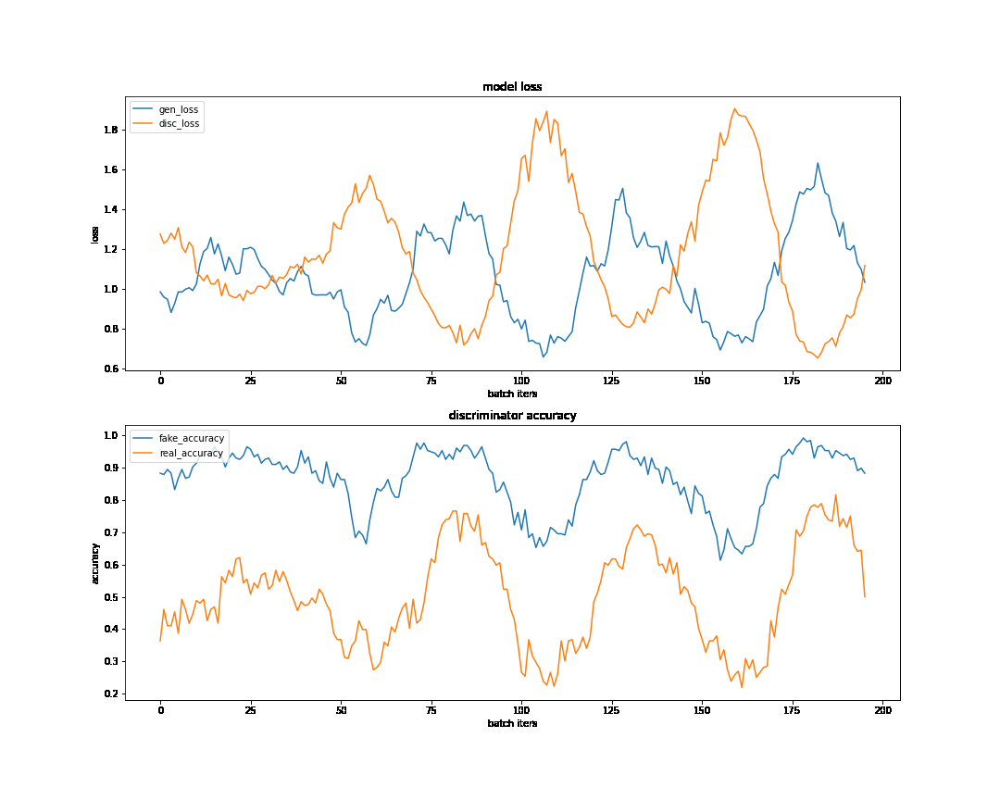

<hr>

# **🌲 EXPLORATION 14-4 : 결론**

처음에 생성한 이미지에 비해 2,3차 개선을 진행했을 때의 결과가 가장 좋은 모습을 보여준다. 2,3차간 유의미한 차이는 없었기 때문에 같은 epoch을 진행했을 때 더 짧은 시간이 걸린 2번째 개선안이 가장 좋다고 판단했다. 2번째 개선안은 처음 생성 이미지에 좀 더 레이어를 추가하고, momentum=0.9 와 alpha=0.1 추가해 같은 epoch 값으로 진행하였다. 2차 개선안 이미지와 3차 개선안 이미지간의 큰 차이는 없지만 색에 따라 이미지 형상의 뚜렷함에 차이를 보였다. 2차 개선안의 경우 푸른 계열의 이미지 형상이 더 뚜렷하게 표현된 반면, 3차 개선안의 경우 붉은 계열의 이미지 형상이 더 뚜렷하게 표현되었다. 

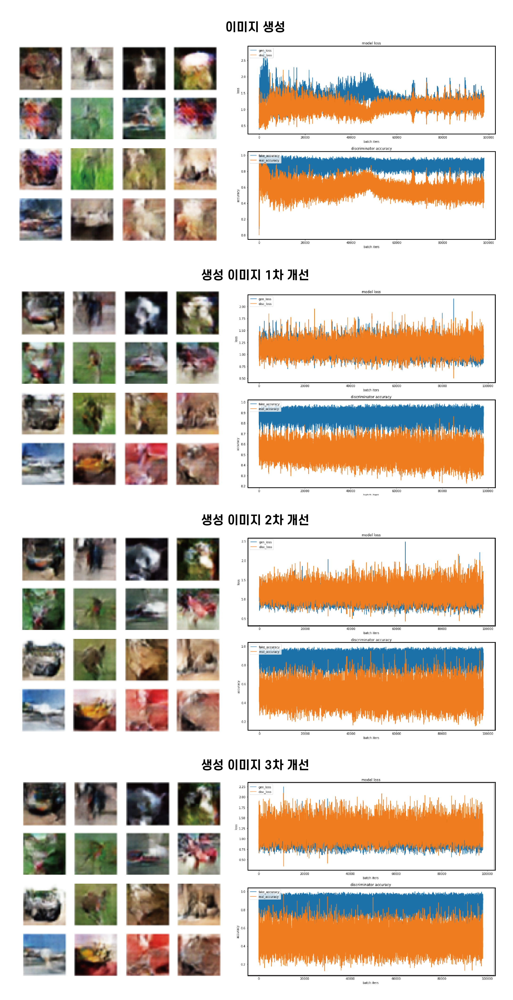

<hr>